# HW3.  Database Design

### Objectives
In this assignment, you will practice:

How to interpret, modify and correct an ER diagram, if it has a problem.

How to use Design Theory to refine a database you have designed.

How to use Normalization Theory, in particular:

How to determine which Functional Dependencies (FDs) are implied.

How to determine which Inclusion Dependencies (INDs) are implied.

How to find all candidate keys and prime attributes of the schema.

How to determine whether a given schema is in BCNF.



Useful resources for writing math in the jupyter notebook:

https://towardsdatascience.com/write-markdown-latex-in-the-jupyter-notebook-10985edb91fd

## Q1 (8 points, 2 points each) 

Consider the E-R diagram in the following figure for questions 1.1 to 1.4.  For each question, pick one answer from the choices offered.
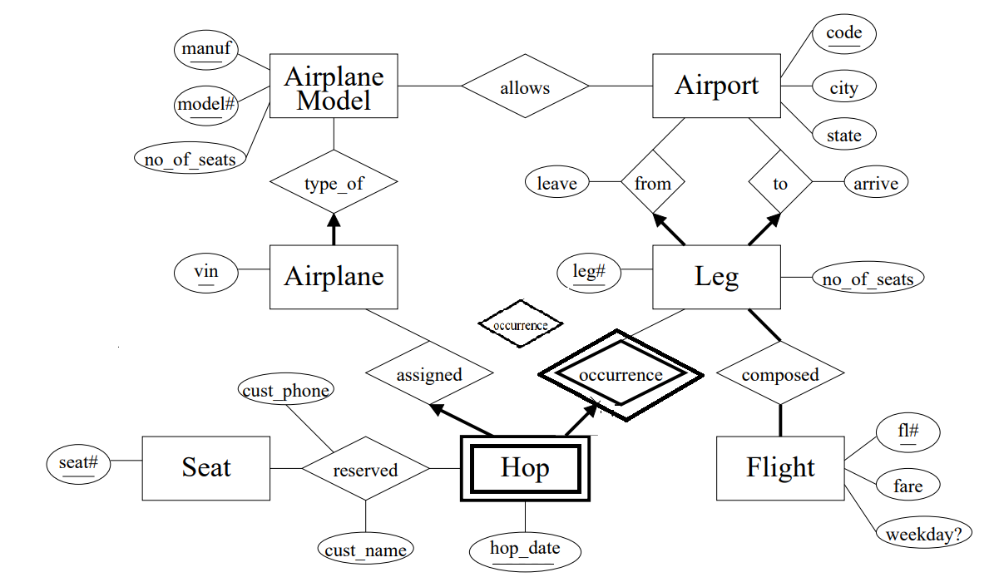


1.1 How do we know the flight (fl) to which a hop belongs?

* (a) We cannot know from the diagram as written because there is a mistake: Hop ought to have
an attribute fl#.
* (b) By the logic of the E-R diagram, it does not make sense to ask which fl# to which a Hop
belongs. Hop and Flight are not related.
* (c) A Hop is associated with an Airplane. An Airplane is associated with at most one Flight.
Hence, we know the Flight to which a Hop “belongs” via its Airplane.
* (d) A Hop is associated with a Leg (via occurrence). We see fl# is the key of Flight. Hence, we
know the Flight to which a Hop “belongs” via the Leg that they have in common.
* (e) By the logic of the E-R diagram, we do not know the Flight’s fl#, because a Hop can be
associated with many flights

1.2 How do we know what airport (code) a hop leaves from?
* (a) We cannot know from the diagram as written because there is a mistake: Hop ought to have an attribute from code.
* (b) By the logic of the E-R diagram, it does not make sense to ask which Airport (code) a Hop departs from. Hop and Airport are not related.
* (c) A Hop is associated with Airplane. A given Airplane only leaves from one given Airport. Hence, we know the Airport from which a Hop departs via the Airplane.
* (d) A Hop is associated with Leg (via occurrence). A Leg leaves from a given Airport. Hence, we know which Airport the Hop leaves from.
* (e) By the logic of the E-R diagram, we do not know the Airport’s code a Hop departs from, because a Hop can be associated with many airports (via from).

1.3 Which of the following seems to be a logical problem with the E-R design?
* (a) More than one customer may be assigned to a given Seat for a given Hop.
* (b) A given Hop may be assigned to more than one Airplane.
* (c) A given Leg may be assigned to more than one Airplane.
* (d) Different Airplane Models probably have different numbers of Seats; the design does not capture this.
* (e) A Flight can be composed of at most two Legs (“non-stop” flights)

1.4 Are we assured by the logic of the E-R diagram that the airplane assigned to a Hop (an
occurrence of a scheduled Leg) is, in fact, allowed to take off from, and to land at, the airports for
which the leg is scheduled to leave and arrive?
* (a) Clearly yes.
* (b) Clearly not.
* (c) It depends on one’s interpretation of the diagram. Under one evident interpretation, the
answer would be “yes”. Under another, “no”.
* (d) In the model, all airplanes are allowed at all airports.
* (e) Oddly, the diagram assures this for the departure airport, but not the arrival airport.


dddb  
1.1. (d)  
1.2. (d)   
1.3. (d)   
1.4. (b)  


## Q2 (10 points) 

Imagine we want to build a music database with the following characteristics:
 - An **artist** is known by their name. We also keep an artist's *genre*, *hometown*, *bio*, and *homepage* in the database.
 - An **album** has an artist. It is produced by a *recording company*.
 - An album is known by *name* of the album and the *name* of its artist. We also keep *year*, *number of tracks* (at least one), and the *recording studio* for an album.
 - An album has songs on the album. 
 - A **recording company** is known by its name. We also keep *address*, *homepage*, and *telephone number* for a *recording company*.
 - A **song** is known by its *name*, *name* of its artist, and the *album* it is part of. We also keep *length* and *track number* for the song. A song might have *guest musicians*. A song may have a *tablature*.
 - A **tablature** is known by the *URL*. We keep *date*, *transcriber*, and transcriber *email* for a tablature.
 - A **musician** is known by their *name*. A musician should have an *instrument*. We also keep *hometown* for a musician.
 - Musicians and an artist can be in a group.
 - Artists might influence a musician.
 
 Design the ERM to capture this database. Please note that you do not need to submit your ERM design, but you need to use it to answer following questions.

Q2.1 (5 points) Please list your schemas (not create table statements). Follow the style of the bank schema in HW2 for your answers.
Ensure your relations are in BCNF.



| **Entity**            | **Attributes**                                                                                       |
|-----------------------|------------------------------------------------------------------------------------------------------|
| **Artist**            | <u>artist_name</u>, genre, hometown, bio, homepage                                                  |
| **Musician**          | <u>musician_name</u>, instrument, hometown                                                           |
| **Artist_Musician**   | <u>artist_name</u><sup>FK-Artist</sup>, <u>musician_name</u><sup>FK-Musician</sup>                  |
| **Artist_Influence**  | <u>influencer_artist_name</u><sup>FK-Artist</sup>, <u>influenced_musician_name</u><sup>FK-Musician</sup>|
| **RecordingCompany**  | <u>company_name</u>, address, homepage, telephone_number                                            |
| **Album**             | <u>album_name</u>, <u>artist_name</u><sup>FK-Artist</sup>, year, num_tracks, recording_studio, company_name<sup>FK-RecordingCompany</sup> |
| **Song**              | <u>song_name</u>, <u>artist_name</u>, <u>album_name</u>, length, track_number                        |
| **Song_Musician**     | <u>song_name</u>, <u>artist_name</u>, <u>album_name</u>, <u>musician_name</u><sup>FK-Musician</sup>  |
| **Tablature**         | <u>url</u>, song_name<sup>FK-Song</sup>, artist_name<sup>FK-Song</sup>, album_name<sup>FK-Song</sup>, date, transcriber, transcriber_email |


(artist_name, album_name) references Album(artist_name, album_name)  


Q2.2 (5 points) Please list the functional dependencies in your relations, based on your answer in Q2.1.


| **Entity**           | **Functional Dependencies**                                                                                   |
|----------------------|----------------------------------------------------------------------------------------------------------------|
| **Artist**           | artist_name `→` genre, hometown, bio, homepage                                                                |
| **Musician**         | musician_name `→` instrument, hometown                                                                        |
| **Artist_Musician**  | No non-trivial FDs (both attributes form the key)                                                              |
| **Artist_Influence** | No non-trivial FDs (both attributes form the key)                                                              |
| **RecordingCompany** | company_name `→` address, homepage, telephone_number                                                           |
| **Album**            | album_name, artist_name `→` year, num_tracks, recording_studio, company_name                                   |
| **Song**             | song_name, artist_name, album_name `→` length, track_number                                                  |
| **Song_Musician**    | No non-trivial FDs (all attributes form the key)                                                               |
| **Tablature**        | url `→` song_name, artist_name, album_name, date, transcriber, transcriber_email                              |
|                      | song_name, artist_name, album_name, transcriber `→` url, date, transcriber_email                              |


## Q3 (12 points)

Consider the following set of FDs:

$D \rightarrow AC$

$AB \rightarrow DE$

$FD \rightarrow E$

$C \rightarrow F$           

Q3.1 (6 points) Determine whether each of the following FDs is implied by the FDs above:

 (a) $EF \rightarrow BC$
 
 (b) $BC \rightarrow BF$
 
 (c) $DEF \rightarrow AB$
 
 (d) $DF \rightarrow AE$
 
 (e) $CD \rightarrow ED$
 
 (f) $DE \rightarrow AF$

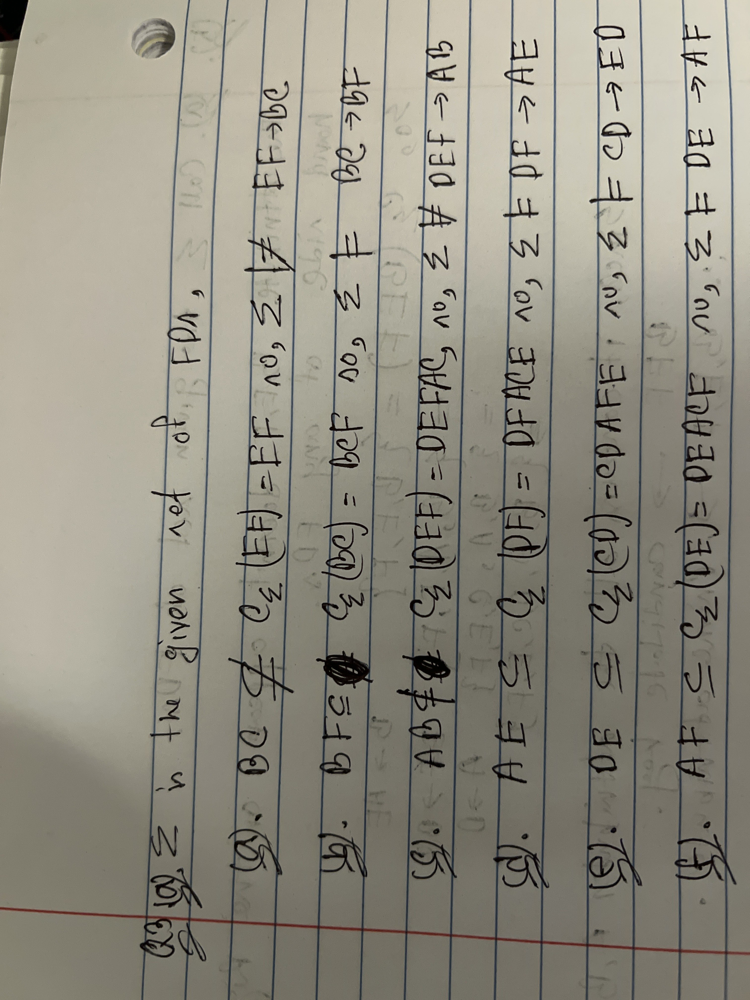

Q3.2 (6 points) For each of the FDs in Q2.1 that are implied, give a derivation
    using the Armostrong's axioms.

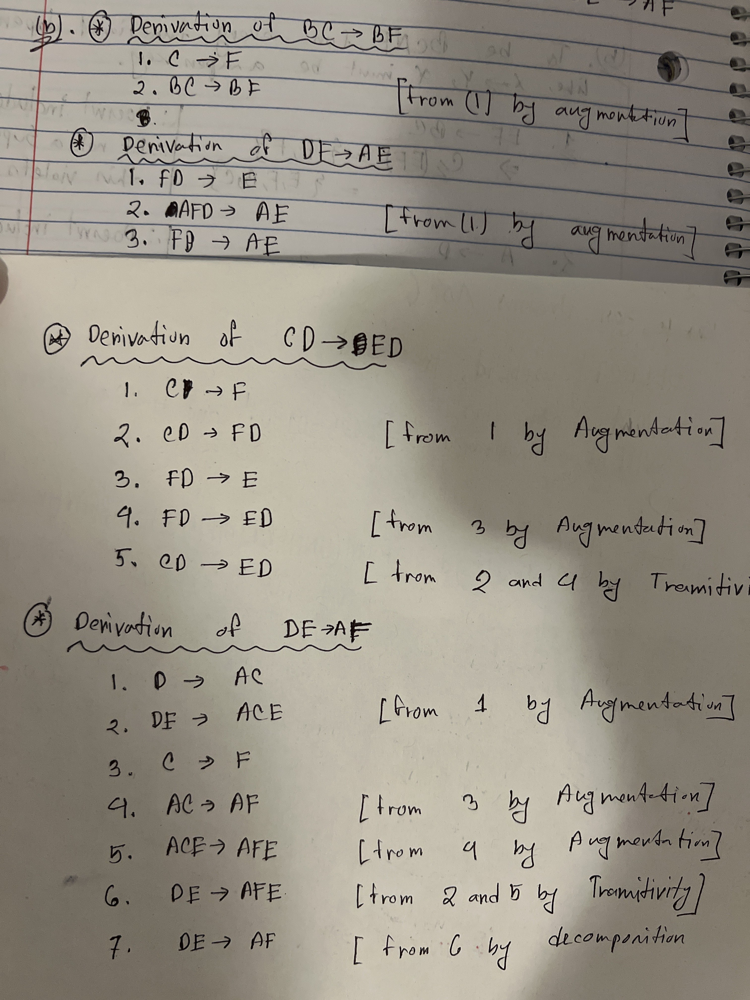

## Q4 (4 points)

Let $R$, $S$ and $T$ be relations on attributes $A,B,C$. Given the following
  set of INDs:
  
   $R[A,B] \subseteq S[B,C] $
   
   $ S[B,C] \subseteq T[C,A]$
   
  Determine which of the following INDs are implied:  
  (a) $R[C] \subseteq T[C]$
  
  (b) $R[B] \subseteq T[C]$
  
  (c)$R[A] \subseteq T[C]$
  
  (d) $R[C] \subseteq T[A]$
  


lets call Σ the given set of INDs. Using the axioms for INDs, we can compute the closure Σ⁺ of Σ:  

Given INDs:  
(1) $ R[A, B] \subseteq S[B, C] $ [given in Σ]  
(2) $ S[B, C] \subseteq T[C, A] $ [given in Σ]

(3) $ R[A] \subseteq S[B] $ [from (1) by projection]  
(4) $ S[B] \subseteq T[C] $ [from (2) by projection]  
(5) $ R[B] \subseteq S[C] $ [from (1) by projection]  
(6) $ S[C] \subseteq T[A] $ [from (2) by projection]  

(7) $ R[B, A] \subseteq S[C, B] $ [from (1) by permutation]  
(8) $ S[C, B] \subseteq T[A, C] $ [from (2) by permutation]  

(9) $ R[A] \subseteq T[C] $ [from (3) and (4) by transitivity]  
(10) $ R[B] \subseteq T[A] $ [from (5) and (6) by transitivity]  

(11) All trivial INDs obtained by reflexivity.  

Checking the Given INDs:  
(a) $ R[C] \subseteq T[C] $ → Not implied  
(b) $ R[B] \subseteq T[C] $ → Not implied  
(c) $ R[A] \subseteq T[C] $ → Implied (as seen in step (9))  
(d) $ R[C] \subseteq T[A] $ → Not implied  

Final Answer:  
$ R[A] \subseteq T[C] $ is implied by Σ (because it appears in Σ⁺).  

## Q5  (10 points)

Consider the schema over attributes $A,B,C,D,E,F$ and the following set of FDs:

$EF \rightarrow BC $

$A \rightarrow D $

$B \rightarrow AE $

$BD \rightarrow C$


Q5.1 (6 points) Find all candidate keys and prime attributes of the schema.


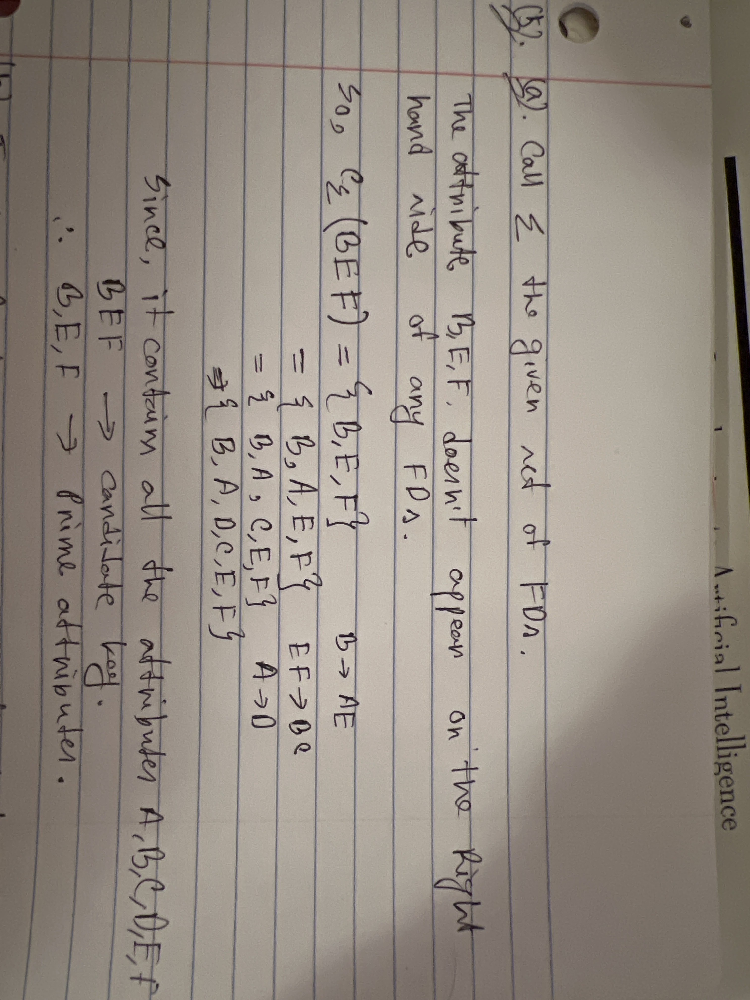

Q5.2 (4 points) Is the schema in BCNF? Justify your answer.

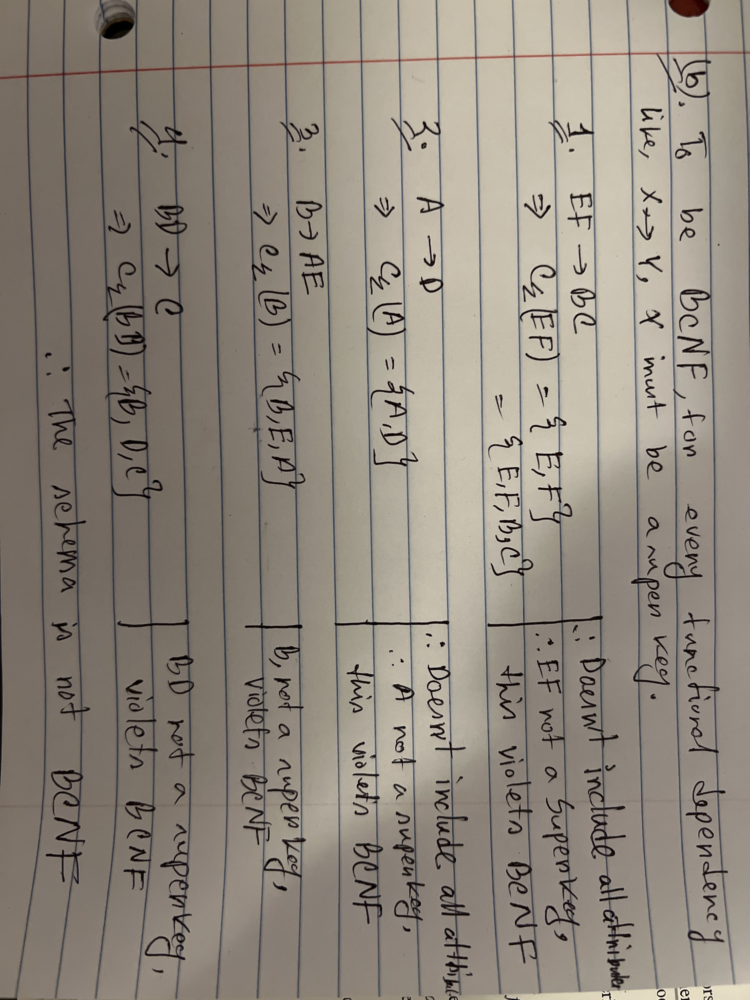

## Submission

Complete the code in this notebook [hw3.ipynb](hw3.ipynb) and submit it to the Canvas activity Homework(3). Please note than you can insert additional cells if required for your answers.